# Book recommendation system

* The goal of this project is to build a recommendation system to predict book titles based on the input of book name and to offer suggestions with a list of books that match the features of the book name, such as language, rating.

In [2]:
import numpy as np 
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

## Loading dataset

In [3]:
books = pd.read_csv('books.csv', error_bad_lines=False)
books

C:\Users\shade\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3165: DtypeWarning: Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...
...,...,...,...,...,...,...,...,...
271355,0440400988,There's a Bat in Bunk Five,Paula Danziger,1988,Random House Childrens Pub (Mm),http://images.amazon.com/images/P/0440400988.0...,http://images.amazon.com/images/P/0440400988.0...,http://images.amazon.com/images/P/0440400988.0...
271356,0525447644,From One to One Hundred,Teri Sloat,1991,Dutton Books,http://images.amazon.com/images/P/0525447644.0...,http://images.amazon.com/images/P/0525447644.0...,http://images.amazon.com/images/P/0525447644.0...
271357,006008667X,Lily Dale : The True Story of the Town that Ta...,Christine Wicker,2004,HarperSanFrancisco,http://images.amazon.com/images/P/006008667X.0...,http://images.amazon.com/images/P/006008667X.0...,http://images.amazon.com/images/P/006008667X.0...
271358,0192126040,Republic (World's Classics),Plato,1996,Oxford University Press,http://images.amazon.com/images/P/0192126040.0...,http://images.amazon.com/images/P/0192126040.0...,http://images.amazon.com/images/P/0192126040.0...


In [4]:
ratings = pd.read_csv('ratings.csv', error_bad_lines=False)
ratings

,User-ID,ISBN,Book-Rating
0,276725,034545104X,0
1,276726,0155061224,5
2,276727,0446520802,0
3,276729,052165615X,3
4,276729,0521795028,6
...,...,...,...
1149775,276704,1563526298,9
1149776,276706,0679447156,0
1149777,276709,0515107662,10
1149778,276721,0590442449,10


In [5]:
users = pd.read_csv('users.csv', error_bad_lines=False)
users

,User-ID,Location,Age
0,1,"nyc, new york, usa",NaN
1,2,"stockton, california, usa",18.0
2,3,"moscow, yukon territory, russia",NaN
3,4,"porto, v.n.gaia, portugal",17.0
4,5,"farnborough, hants, united kingdom",NaN
...,...,...,...
278853,278854,"portland, oregon, usa",NaN
278854,278855,"tacoma, washington, united kingdom",50.0
278855,278856,"brampton, ontario, canada",NaN
278856,278857,"knoxville, tennessee, usa",NaN


In [6]:
users_ratings = ratings.merge(users, left_on = 'User-ID', right_on = 'User-ID')

In [7]:
users_ratings

,User-ID,ISBN,Book-Rating,Location,Age
0,276725,034545104X,0,"tyler, texas, usa",NaN
1,276726,0155061224,5,"seattle, washington, usa",NaN
2,276727,0446520802,0,"h, new south wales, australia",16.0
3,276729,052165615X,3,"rijeka, n/a, croatia",16.0
4,276729,0521795028,6,"rijeka, n/a, croatia",16.0
...,...,...,...,...,...
1149775,276704,1563526298,9,"cedar park, texas, usa",NaN
1149776,276706,0679447156,0,"quebec, quebec, canada",18.0
1149777,276709,0515107662,10,"mannington, west virginia, usa",38.0
1149778,276721,0590442449,10,"providence, rhode island, usa",14.0


In [8]:
books.isna().sum()

ISBN                   0
Book-Title             0
Book-Author            1
Year-Of-Publication    0
Publisher              2
Image-URL-S            0
Image-URL-M            0
Image-URL-L            3
dtype: int64

In [9]:
books=books.dropna()

In [10]:
books.isna().sum()

ISBN                   0
Book-Title             0
Book-Author            0
Year-Of-Publication    0
Publisher              0
Image-URL-S            0
Image-URL-M            0
Image-URL-L            0
dtype: int64

In [11]:
users_ratings.isna().sum()

User-ID             0
ISBN                0
Book-Rating         0
Location            0
Age            309492
dtype: int64

In [12]:
users_ratings=users_ratings.dropna()

In [13]:
users_ratings.isna().sum()

User-ID        0
ISBN           0
Book-Rating    0
Location       0
Age            0
dtype: int64

In [14]:
books

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...
...,...,...,...,...,...,...,...,...
271355,0440400988,There's a Bat in Bunk Five,Paula Danziger,1988,Random House Childrens Pub (Mm),http://images.amazon.com/images/P/0440400988.0...,http://images.amazon.com/images/P/0440400988.0...,http://images.amazon.com/images/P/0440400988.0...
271356,0525447644,From One to One Hundred,Teri Sloat,1991,Dutton Books,http://images.amazon.com/images/P/0525447644.0...,http://images.amazon.com/images/P/0525447644.0...,http://images.amazon.com/images/P/0525447644.0...
271357,006008667X,Lily Dale : The True Story of the Town that Ta...,Christine Wicker,2004,HarperSanFrancisco,http://images.amazon.com/images/P/006008667X.0...,http://images.amazon.com/images/P/006008667X.0...,http://images.amazon.com/images/P/006008667X.0...
271358,0192126040,Republic (World's Classics),Plato,1996,Oxford University Press,http://images.amazon.com/images/P/0192126040.0...,http://images.amazon.com/images/P/0192126040.0...,http://images.amazon.com/images/P/0192126040.0...


In [15]:
users_ratings

,User-ID,ISBN,Book-Rating,Location,Age
2,276727,0446520802,0,"h, new south wales, australia",16.0
3,276729,052165615X,3,"rijeka, n/a, croatia",16.0
4,276729,0521795028,6,"rijeka, n/a, croatia",16.0
5,276733,2080674722,0,"paris, n/a, france",37.0
7,276737,0600570967,6,"sydney, new south wales, australia",14.0
...,...,...,...,...,...
1149758,276697,8445072897,0,"oviedo, asturias, spain",29.0
1149776,276706,0679447156,0,"quebec, quebec, canada",18.0
1149777,276709,0515107662,10,"mannington, west virginia, usa",38.0
1149778,276721,0590442449,10,"providence, rhode island, usa",14.0


## EDA

In [16]:
books.size

2170832

In [17]:
books.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 271354 entries, 0 to 271359
Data columns (total 8 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   ISBN                 271354 non-null  object
 1   Book-Title           271354 non-null  object
 2   Book-Author          271354 non-null  object
 3   Year-Of-Publication  271354 non-null  object
 4   Publisher            271354 non-null  object
 5   Image-URL-S          271354 non-null  object
 6   Image-URL-M          271354 non-null  object
 7   Image-URL-L          271354 non-null  object
dtypes: object(8)
memory usage: 18.6+ MB


In [18]:
users_ratings.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 840288 entries, 2 to 1149779
Data columns (total 5 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   User-ID      840288 non-null  int64  
 1   ISBN         840288 non-null  object 
 2   Book-Rating  840288 non-null  int64  
 3   Location     840288 non-null  object 
 4   Age          840288 non-null  float64
dtypes: float64(1), int64(2), object(2)
memory usage: 38.5+ MB


In [19]:
#diagram isbn for each book

In [20]:
#how many user rating 


In [21]:
books.columns

Index(['ISBN', 'Book-Title', 'Book-Author', 'Year-Of-Publication', 'Publisher',
       'Image-URL-S', 'Image-URL-M', 'Image-URL-L'],
      dtype='object')

In [22]:
books.dtypes

ISBN                   object
Book-Title             object
Book-Author            object
Year-Of-Publication    object
Publisher              object
Image-URL-S            object
Image-URL-M            object
Image-URL-L            object
dtype: object

In [23]:
users_ratings.columns

Index(['User-ID', 'ISBN', 'Book-Rating', 'Location', 'Age'], dtype='object')

In [24]:
users_ratings.dtypes

User-ID          int64
ISBN            object
Book-Rating      int64
Location        object
Age            float64
dtype: object

In [25]:
df = pd.merge(books,users_ratings,on='ISBN') 

In [26]:
df

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L,User-ID,Book-Rating,Location,Age
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,2,0,"stockton, california, usa",18.0
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,11400,0,"ottawa, ontario, canada",49.0
2,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,67544,8,"toronto, ontario, canada",30.0
3,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,85526,0,"victoria, british columbia, canada",36.0
4,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,96054,0,"ottawa, ontario, canada",29.0
...,...,...,...,...,...,...,...,...,...,...,...,...
753291,0440400988,There's a Bat in Bunk Five,Paula Danziger,1988,Random House Childrens Pub (Mm),http://images.amazon.com/images/P/0440400988.0...,http://images.amazon.com/images/P/0440400988.0...,http://images.amazon.com/images/P/0440400988.0...,276463,7,"providence, rhode island, usa",26.0
753292,0525447644,From One to One Hundred,Teri Sloat,1991,Dutton Books,http://images.amazon.com/images/P/0525447644.0...,http://images.amazon.com/images/P/0525447644.0...,http://images.amazon.com/images/P/0525447644.0...,276579,4,"orem, utah, usa",12.0
753293,006008667X,Lily Dale : The True Story of the Town that Ta...,Christine Wicker,2004,HarperSanFrancisco,http://images.amazon.com/images/P/006008667X.0...,http://images.amazon.com/images/P/006008667X.0...,http://images.amazon.com/images/P/006008667X.0...,276680,0,"hopewell junction, new york, usa",55.0
753294,0192126040,Republic (World's Classics),Plato,1996,Oxford University Press,http://images.amazon.com/images/P/0192126040.0...,http://images.amazon.com/images/P/0192126040.0...,http://images.amazon.com/images/P/0192126040.0...,276680,0,"hopewell junction, new york, usa",55.0


In [27]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 753296 entries, 0 to 753295
Data columns (total 12 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   ISBN                 753296 non-null  object 
 1   Book-Title           753296 non-null  object 
 2   Book-Author          753296 non-null  object 
 3   Year-Of-Publication  753296 non-null  object 
 4   Publisher            753296 non-null  object 
 5   Image-URL-S          753296 non-null  object 
 6   Image-URL-M          753296 non-null  object 
 7   Image-URL-L          753296 non-null  object 
 8   User-ID              753296 non-null  int64  
 9   Book-Rating          753296 non-null  int64  
 10  Location             753296 non-null  object 
 11  Age                  753296 non-null  float64
dtypes: float64(1), int64(2), object(9)
memory usage: 74.7+ MB


In [28]:
df['Location']

0                  stockton, california, usa
1                    ottawa, ontario, canada
2                   toronto, ontario, canada
3         victoria, british columbia, canada
4                    ottawa, ontario, canada
                         ...                
753291         providence, rhode island, usa
753292                       orem, utah, usa
753293      hopewell junction, new york, usa
753294      hopewell junction, new york, usa
753295      hopewell junction, new york, usa
Name: Location, Length: 753296, dtype: object

In [29]:
df[['a','city','country','b','c','d','e']]=df['Location'].str.split(',', expand=True)
df

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L,User-ID,Book-Rating,Location,Age,a,city,country,b,c,d,e
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,2,0,"stockton, california, usa",18.0,stockton,california,usa,None,None,None,None
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,11400,0,"ottawa, ontario, canada",49.0,ottawa,ontario,canada,None,None,None,None
2,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,67544,8,"toronto, ontario, canada",30.0,toronto,ontario,canada,None,None,None,None
3,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,85526,0,"victoria, british columbia, canada",36.0,victoria,british columbia,canada,None,None,None,None
4,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,96054,0,"ottawa, ontario, canada",29.0,ottawa,ontario,canada,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
753291,0440400988,There's a Bat in Bunk Five,Paula Danziger,1988,Random House Childrens Pub (Mm),http://images.amazon.com/images/P/0440400988.0...,http://images.amazon.com/images/P/0440400988.0...,http://images.amazon.com/images/P/0440400988.0...,276463,7,"providence, rhode island, usa",26.0,providence,rhode island,usa,None,None,None,None
753292,0525447644,From One to One Hundred,Teri Sloat,1991,Dutton Books,http://images.amazon.com/images/P/0525447644.0...,http://images.amazon.com/images/P/0525447644.0...,http://images.amazon.com/images/P/0525447644.0...,276579,4,"orem, utah, usa",12.0,orem,utah,usa,None,None,None,None
753293,006008667X,Lily Dale : The True Story of the Town that Ta...,Christine Wicker,2004,HarperSanFrancisco,http://images.amazon.com/images/P/006008667X.0...,http://images.amazon.com/images/P/006008667X.0...,http://images.amazon.com/images/P/006008667X.0...,276680,0,"hopewell junction, new york, usa",55.0,hopewell junction,new york,usa,None,None,None,None
753294,0192126040,Republic (World's Classics),Plato,1996,Oxford University Press,http://images.amazon.com/images/P/0192126040.0...,http://images.amazon.com/images/P/0192126040.0...,http://images.amazon.com/images/P/0192126040.0...,276680,0,"hopewell junction, new york, usa",55.0,hopewell junction,new york,usa,None,None,None,None


In [30]:
spec_chars = ["!",'"',"#","%","&","'","(",")",
              "*","+",",","-",".",":","/",";","<",
              "=",">","?","@","[","\\","]","^","_",
              "`","{","|","}","~","–","p","n","b","s","p","b","r", "Ã","©","£","¢"]

for char in spec_chars:
    df['Book-Title'] = df['Book-Title'].str.replace(char, ' ')
    #df['Location'] = df['Location'].str.replace(char, ' ')


<ipython-input-30-28adf48379d7>:7: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will*not* be treated as literal strings when regex=True.
  df['Book-Title'] = df['Book-Title'].str.replace(char, ' ')


In [31]:
df=df.drop(['Image-URL-S', 'Image-URL-M','Image-URL-L','Location','a','city','b','c','d','e'], axis=1)
df

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,User-ID,Book-Rating,Age,country
0,0195153448,Cla ical Mythology,Mark P. O. Morford,2002,Oxford University Press,2,0,18.0,usa
1,0002005018,Cla a Calla,Richard Bruce Wright,2001,HarperFlamingo Canada,11400,0,49.0,canada
2,0002005018,Cla a Calla,Richard Bruce Wright,2001,HarperFlamingo Canada,67544,8,30.0,canada
3,0002005018,Cla a Calla,Richard Bruce Wright,2001,HarperFlamingo Canada,85526,0,36.0,canada
4,0002005018,Cla a Calla,Richard Bruce Wright,2001,HarperFlamingo Canada,96054,0,29.0,canada
...,...,...,...,...,...,...,...,...,...
753291,0440400988,The e a Bat i Bu k Five,Paula Danziger,1988,Random House Childrens Pub (Mm),276463,7,26.0,usa
753292,0525447644,F om O e to O e Hu d ed,Teri Sloat,1991,Dutton Books,276579,4,12.0,usa
753293,006008667X,Lily Dale The T ue Sto y of the Tow that Ta...,Christine Wicker,2004,HarperSanFrancisco,276680,0,55.0,usa
753294,0192126040,Re u lic Wo ld Cla ic,Plato,1996,Oxford University Press,276680,0,55.0,usa


In [32]:
#gkk = df.groupby(['Book-Rating', 'Book-Title'])
#gkk.first()
pd.set_option('display.max_rows', df.shape[0]+1)

In [33]:
df['country']

0                              usa
1                           canada
2                           canada
3                           canada
4                           canada
5                           canada
6                           canada
7                           canada
8                              usa
9                           canada
10                             usa
11                             usa
12                             usa
13                             usa
14                             usa
15                             usa
16                             usa
17                             usa
18                             usa
19                             usa
20                             usa
21                             usa
22                                
23                             usa
24                             usa
25                        malaysia
26                             usa
27                             usa
28                  

In [34]:
#top_ten = df[df['Book-Rating'] == 10]
#top_ten.sort_values(by='Book-Rating', ascending=False).head(10)

C:\Users\shade\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 0, 'Book Rating')

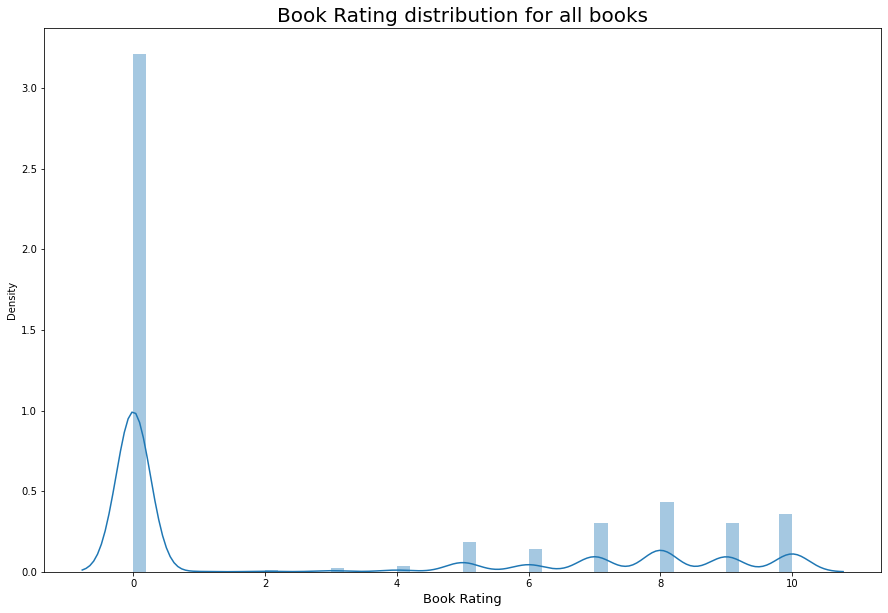

In [35]:
df[['Book-Rating']] = df[['Book-Rating']].astype(int)
fig, ax = plt.subplots(figsize=[15,10])
sns.distplot(df['Book-Rating'],ax=ax)
ax.set_title('Book Rating distribution for all books',fontsize=20)
ax.set_xlabel('Book Rating',fontsize=13)

C:\Users\shade\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


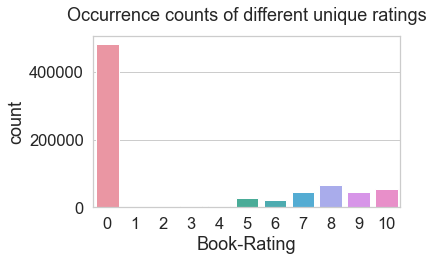

In [36]:
#Number of Rate score
sns.set(font_scale=1.5, style='whitegrid')
sns.countplot(df['Book-Rating'])
plt.title('Occurrence counts of different unique ratings', y=1.05)
plt.tight_layout()
#plt.savefig('Rate.png', bbox_inches='tight')

In [ ]:
df_ratings=df.drop(df.index[df['Book-Rating']  == 0 ], inplace = False)
df_ratings

In [ ]:
#Number of Rate score
sns.set(font_scale=1.5, style='whitegrid')
sns.countplot(df_ratings['Book-Rating'])
plt.title('Occurrence counts of different unique ratings', y=1.05)
plt.tight_layout()
#plt.savefig('Rate.png', bbox_inches='tight')

In [ ]:
#Mean of Rate score
Mean = df_ratings.groupby(by="ISBN",as_index=False)['Book-Rating'].mean()

plt.figure(figsize=(8,6))
plt.title('The Avrage of Number Book Rating', y=1.05)
plt.rcParams['patch.force_edgecolor'] = True
Mean['Book-Rating'].hist(bins=50)
plt.xlabel('Book Rating')
plt.ylabel('Avrage Book Rating')
#plt.savefig('Rate_score.png', bbox_inches='tight')

In [ ]:
top_ten=df_ratings.sort_values('Book-Title')[['Book-Author']].value_counts().to_frame().rename(
         columns={0:'book_counts'}).reset_index()
top_10=top_ten.head(10)

In [ ]:
top_10

In [ ]:
df_sample=df.sample(10)

In [ ]:
#Highest number of books per author 
f, ax = plt.subplots(figsize=(8, 12))
sns.set_color_codes("pastel")
sns.set_style("white")
sns.barplot(x=top_10['book_counts'], y=top_10['Book-Author'], data=top_10, color='b')
ax.set(ylabel='Author',xlabel="Number of Book")
#plt.savefig('Courses.png', bbox_inches='tight')

In [ ]:
#Language distripution(x=number of books,y=language)

In [ ]:
result = df.groupby(['country']).count()
result

In [ ]:
cou_df=df.sort_values('User-ID')[['country']].value_counts().to_frame().rename(
         columns={0:'count_count'}).reset_index()
cou_df=cou_df.head(10)

In [ ]:
#drop row 6 with missing value
cou_df=cou_df.drop([6], axis=0)

In [ ]:
#Plot for count of country
plt.figure(figsize=(35,20))
#a=df['country'].dropna().unique()
survival_rates = cou_df['country']
ax=sns.barplot(cou_df['country'],cou_df['count_count'].dropna(), hue=survival_rates, palette='Spectral',dodge=False)

plt.title('Count of country users', fontsize=50)
ax.set_xlabel('country', fontsize=50)
ax.set_ylabel('Count', fontsize=50)
plt.xticks(size=30)
plt.yticks(size=30)


In [ ]:
#In next step will the features will selected and testing models to find the best model.